# Customer Churn Prediction

This notebook demonstrates a data science approach to predicting customer churn for a telecom provider, with comparison of several types of classifiers.

### Sections
1. EDA
2. Data Preprocessing
3. Model Initialization
4. Model Tuning
5. Results

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import power_transform
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier, AdaBoostClassifier
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV
from sklearn.utils.validation import column_or_1d
import xgboost as xgb

import warnings
warnings.filterwarnings("ignore")

In [2]:
train_raw = pd.read_csv("train.csv")

### 1. EDA

Explore the dataset to assess any necessary preprocessing and select an approach to the model.

In [3]:
# -- check for missing values
train_raw.isna().sum()

state                            0
account_length                   0
area_code                        0
international_plan               0
voice_mail_plan                  0
number_vmail_messages            0
total_day_minutes                0
total_day_calls                  0
total_day_charge                 0
total_eve_minutes                0
total_eve_calls                  0
total_eve_charge                 0
total_night_minutes              0
total_night_calls                0
total_night_charge               0
total_intl_minutes               0
total_intl_calls                 0
total_intl_charge                0
number_customer_service_calls    0
churn                            0
dtype: int64

In [5]:
train_raw.head()

,state,account_length,area_code,international_plan,voice_mail_plan,number_vmail_messages,total_day_minutes,total_day_calls,total_day_charge,total_eve_minutes,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,churn
0,OH,107,area_code_415,no,yes,26,161.6,123,27.47,195.5,103,16.62,254.4,103,11.45,13.7,3,3.70,1,no
1,NJ,137,area_code_415,no,no,0,243.4,114,41.38,121.2,110,10.30,162.6,104,7.32,12.2,5,3.29,0,no
2,OH,84,area_code_408,yes,no,0,299.4,71,50.90,61.9,88,5.26,196.9,89,8.86,6.6,7,1.78,2,no
3,OK,75,area_code_415,yes,no,0,166.7,113,28.34,148.3,122,12.61,186.9,121,8.41,10.1,3,2.73,3,no
4,MA,121,area_code_510,no,yes,24,218.2,88,37.09,348.5,108,29.62,212.6,118,9.57,7.5,7,2.03,3,no


Dataset `test` has an additional column `id` which is index+1

In [6]:
train_raw.describe()

,account_length,number_vmail_messages,total_day_minutes,total_day_calls,total_day_charge,total_eve_minutes,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls
count,4250.000000,4250.000000,4250.000000,4250.000000,4250.000000,4250.000000,4250.000000,4250.000000,4250.000000,4250.000000,4250.000000,4250.000000,4250.000000,4250.000000,4250.000000
mean,100.236235,7.631765,180.259600,99.907294,30.644682,200.173906,100.176471,17.015012,200.527882,99.839529,9.023892,10.256071,4.426353,2.769654,1.559059
std,39.698401,13.439882,54.012373,19.850817,9.182096,50.249518,19.908591,4.271212,50.353548,20.093220,2.265922,2.760102,2.463069,0.745204,1.311434
min,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,73.000000,0.000000,143.325000,87.000000,24.365000,165.925000,87.000000,14.102500,167.225000,86.000000,7.522500,8.500000,3.000000,2.300000,1.000000
50%,100.000000,0.000000,180.450000,100.000000,30.680000,200.700000,100.000000,17.060000,200.450000,100.000000,9.020000,10.300000,4.000000,2.780000,1.000000
75%,127.000000,16.000000,216.200000,113.000000,36.750000,233.775000,114.000000,19.867500,234.700000,113.000000,10.560000,12.000000,6.000000,3.240000,2.000000
max,243.000000,52.000000,351.500000,165.000000,59.760000,359.300000,170.000000,30.540000,395.000000,175.000000,17.770000,20.000000,20.000000,5.400000,9.000000


In [7]:
train_raw.dtypes

state                             object
account_length                     int64
area_code                         object
international_plan                object
voice_mail_plan                   object
number_vmail_messages              int64
total_day_minutes                float64
total_day_calls                    int64
total_day_charge                 float64
total_eve_minutes                float64
total_eve_calls                    int64
total_eve_charge                 float64
total_night_minutes              float64
total_night_calls                  int64
total_night_charge               float64
total_intl_minutes               float64
total_intl_calls                   int64
total_intl_charge                float64
number_customer_service_calls      int64
churn                             object
dtype: object

Extract and display categorical features

In [8]:
cat_ftrs = [features for features in train_raw.columns if train_raw[features].dtype == 'object']
print(cat_ftrs)

['state', 'area_code', 'international_plan', 'voice_mail_plan', 'churn']


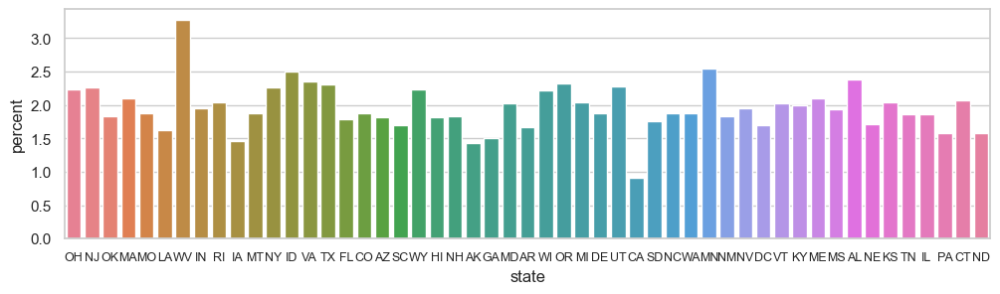

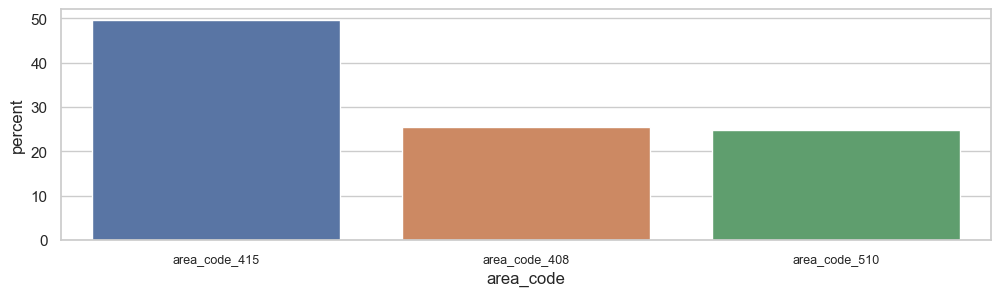

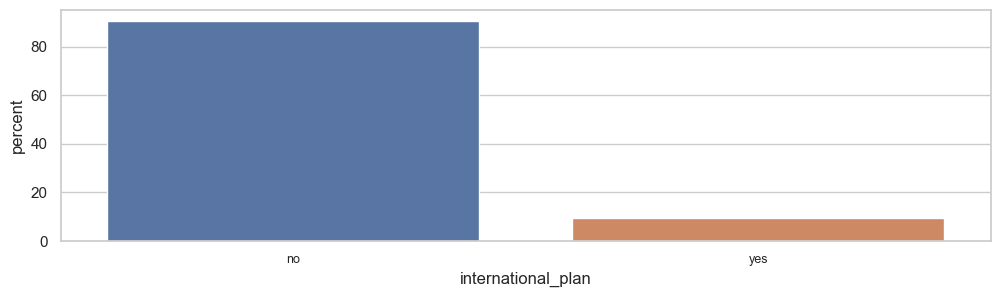

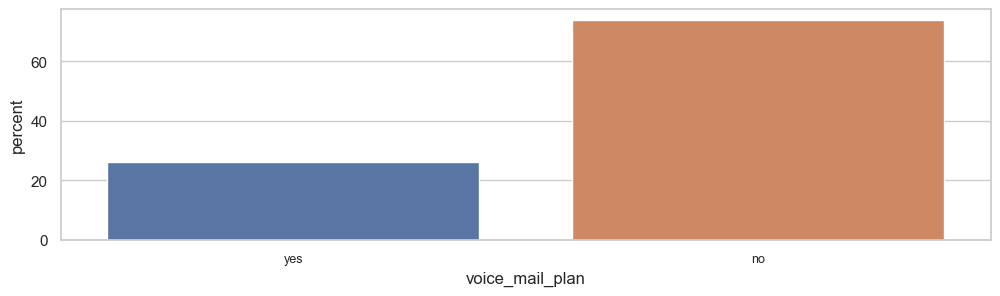

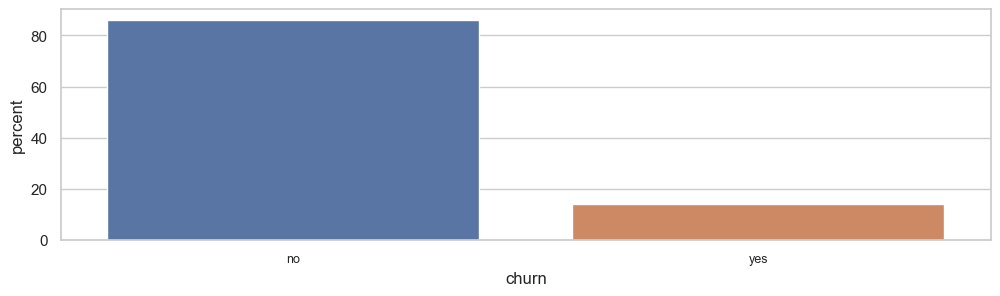

In [9]:
for feature in cat_ftrs:
    sns.set(style = 'whitegrid')
    plt.figure(figsize = (12,3))
    total = len(train_raw)
    ax = sns.countplot(x = train_raw[feature], data = train_raw, stat='percent', hue= train_raw[feature], legend=False)
    plt.xticks(fontsize=9)
    plt.show()

Extract and display numerical features

In [10]:
num_ftrs = [features for features in train_raw.columns if train_raw[features].dtype != 'object']
print(num_ftrs)

['account_length', 'number_vmail_messages', 'total_day_minutes', 'total_day_calls', 'total_day_charge', 'total_eve_minutes', 'total_eve_calls', 'total_eve_charge', 'total_night_minutes', 'total_night_calls', 'total_night_charge', 'total_intl_minutes', 'total_intl_calls', 'total_intl_charge', 'number_customer_service_calls']


<Figure size 1200x300 with 0 Axes>

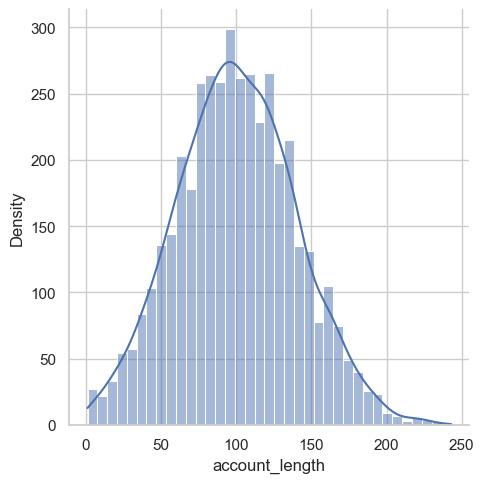

<Figure size 1200x300 with 0 Axes>

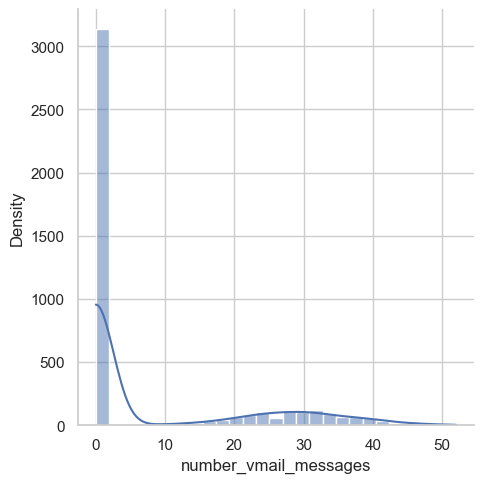

<Figure size 1200x300 with 0 Axes>

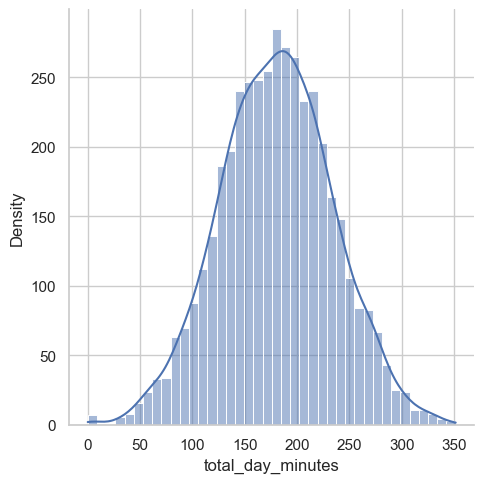

<Figure size 1200x300 with 0 Axes>

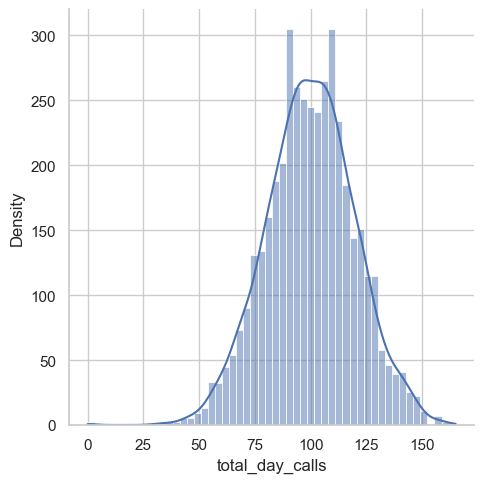

<Figure size 1200x300 with 0 Axes>

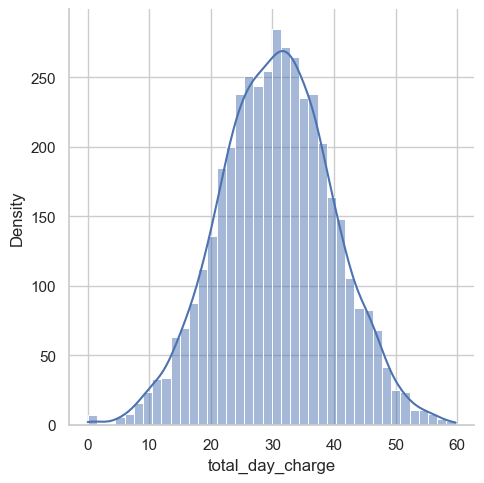

<Figure size 1200x300 with 0 Axes>

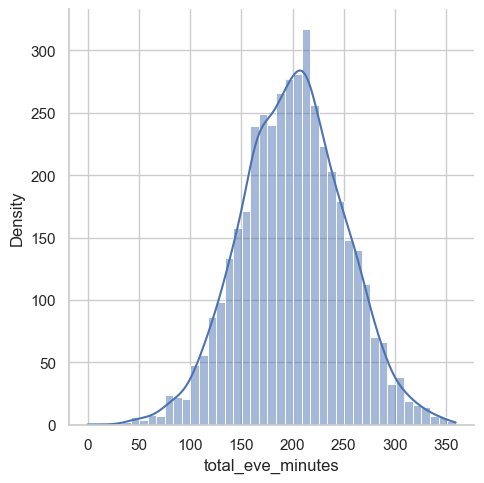

<Figure size 1200x300 with 0 Axes>

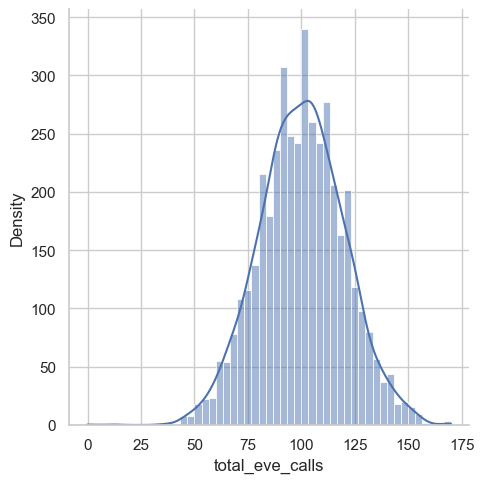

<Figure size 1200x300 with 0 Axes>

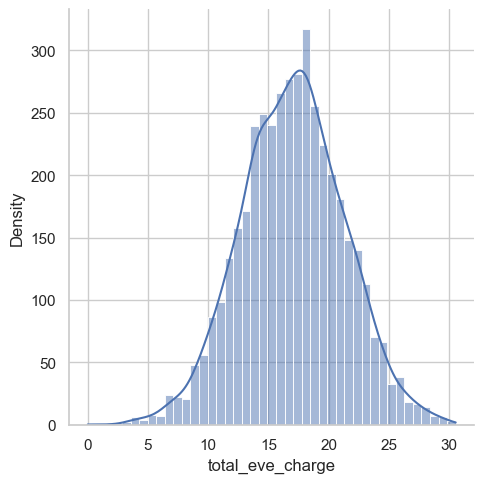

<Figure size 1200x300 with 0 Axes>

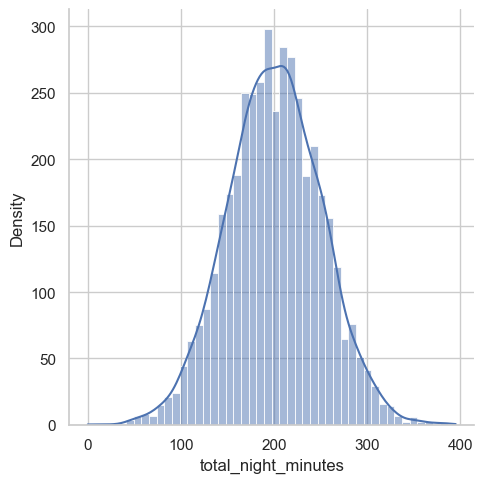

<Figure size 1200x300 with 0 Axes>

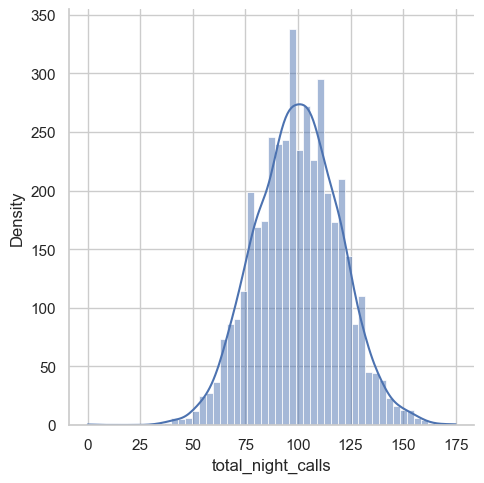

<Figure size 1200x300 with 0 Axes>

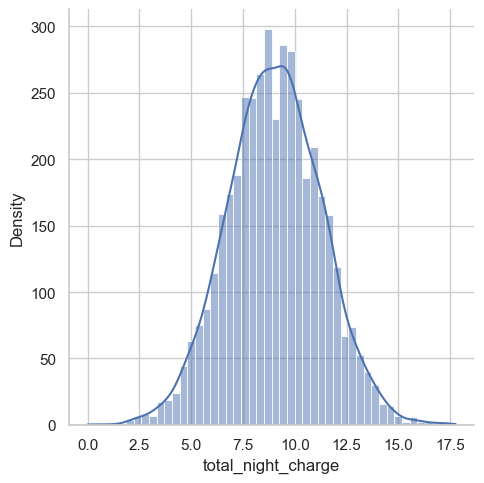

<Figure size 1200x300 with 0 Axes>

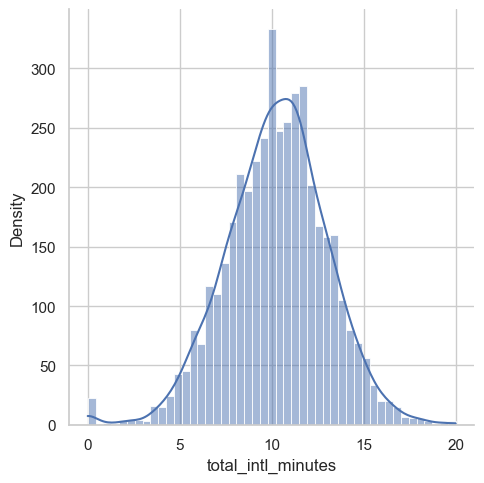

<Figure size 1200x300 with 0 Axes>

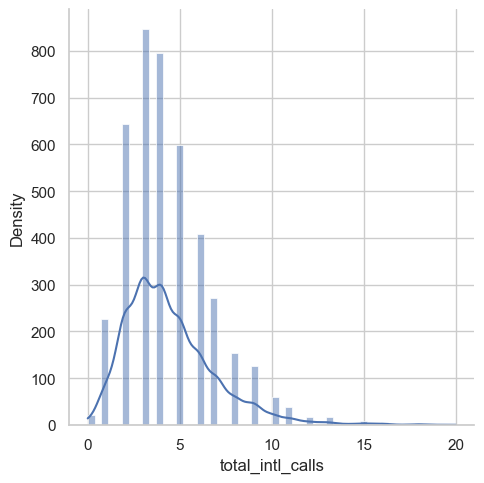

<Figure size 1200x300 with 0 Axes>

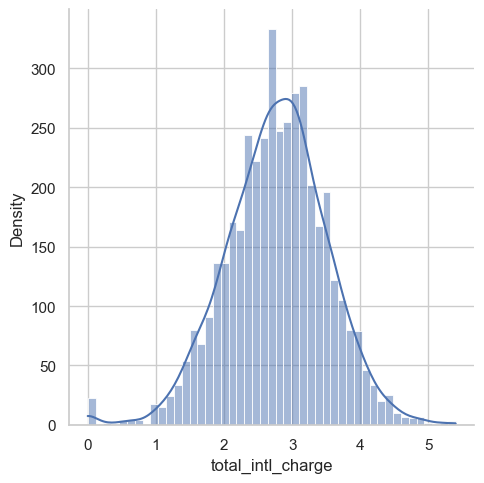

<Figure size 1200x300 with 0 Axes>

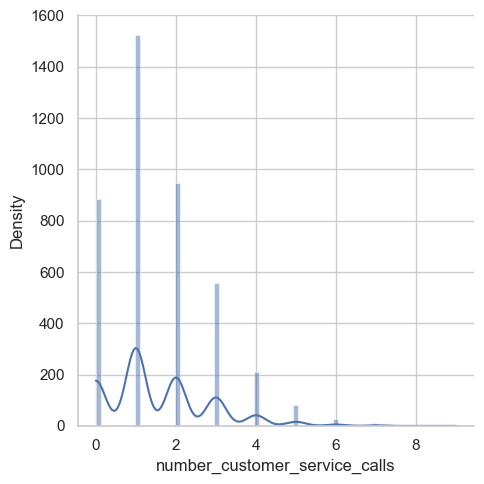

In [11]:
for features in num_ftrs:
    sns.set(style="whitegrid")
    plt.figure(figsize=(12,3))
    sns.displot(train_raw[features],kde=True)
    plt.xlabel(features)
    plt.ylabel('Density')
    plt.show()

Most of the numerical categories have normal distribution, with a few that might work better transformed into log space

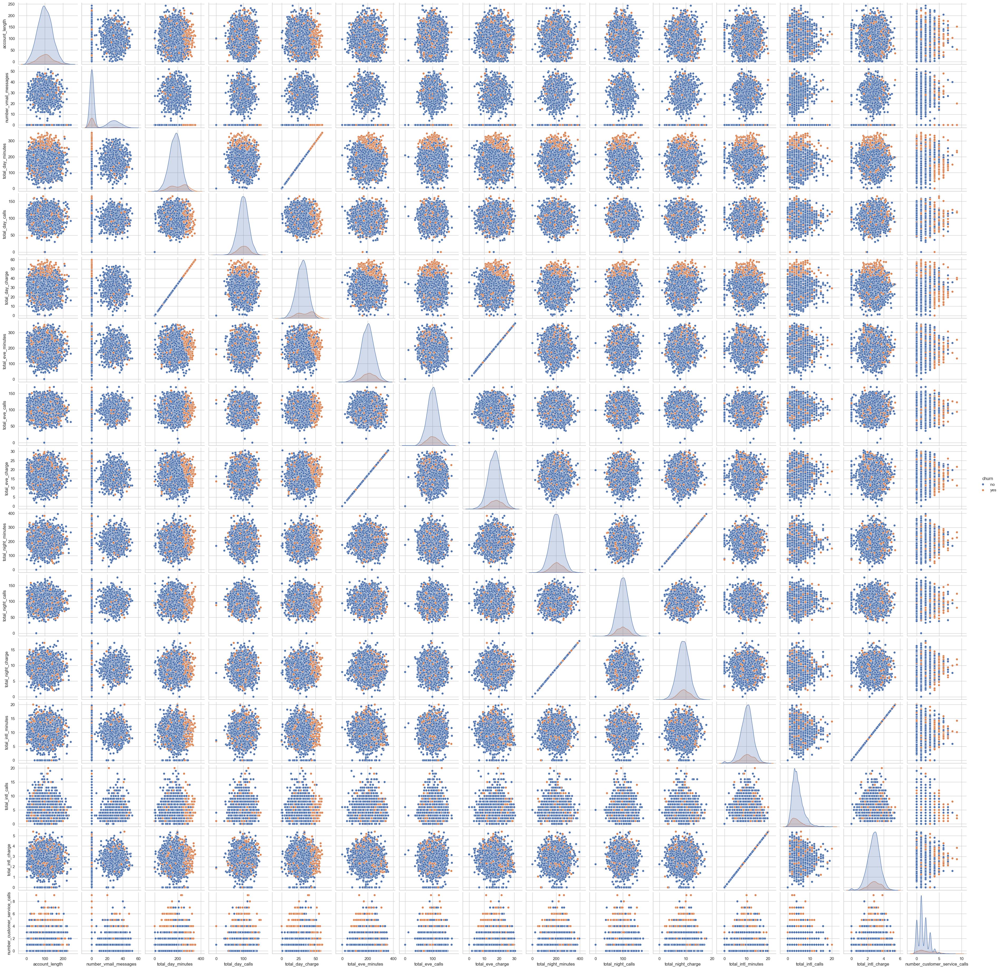

In [12]:
#pairplot_df = train_raw.filter(num_ftrs, axis=1)
sns.pairplot(train_raw, hue="churn")

There are a few features that show a little bit of trend or skew, so we'll look more closely at those (total_day_minutes, total_day_charge, number_customer_service_calls, number_vmail_messages)

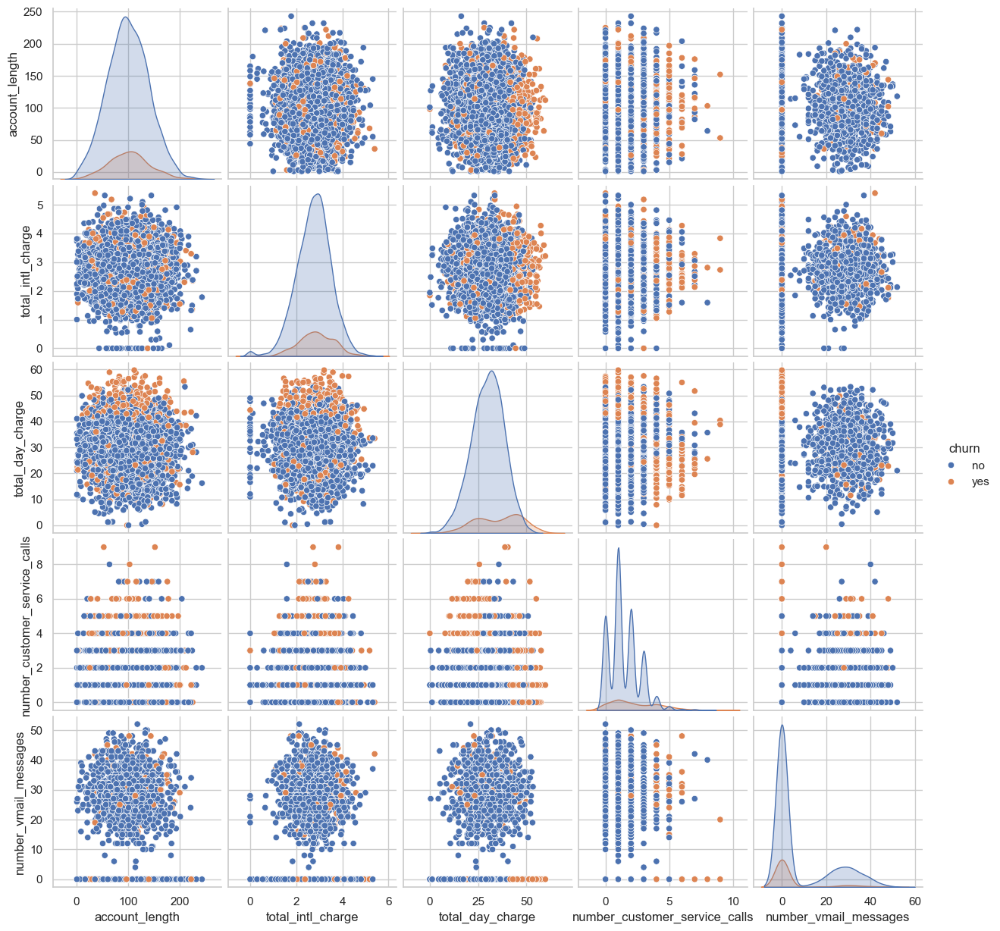

In [13]:
skew_features = ['account_length','total_intl_charge', 'total_day_charge', 'number_customer_service_calls', 'number_vmail_messages', 'churn']
skew_df = train_raw.filter(skew_features, axis=1)
sns.pairplot(skew_df, hue = 'churn')

At first pass, it looks like churn may be positively correlated with high charges and high number of customer service calls. Also, voicemails may have no correlation.

### 2. Data Preprocessing

Before training our model, we'll deal with outliers, normalize/rescale our features, and one-hot encode categoricals.

First, we'll replace some skewed features with Yeo-Johnson scaled versions.

<Figure size 200x200 with 0 Axes>

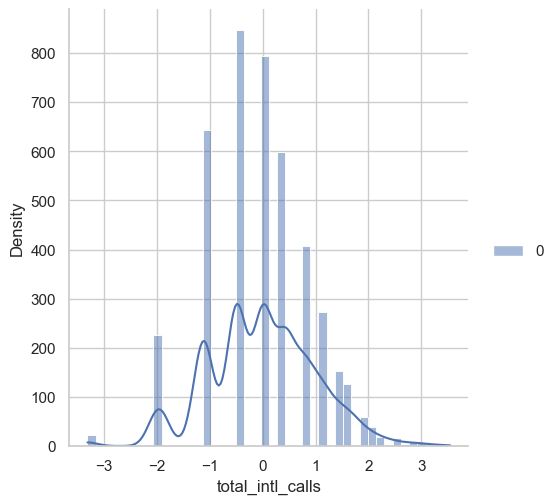

<Figure size 200x200 with 0 Axes>

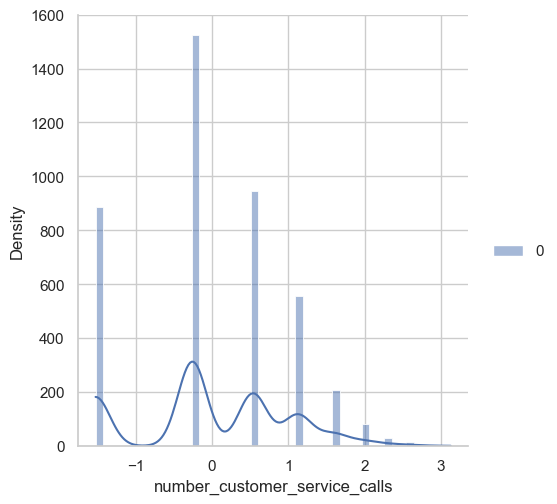

<Figure size 200x200 with 0 Axes>

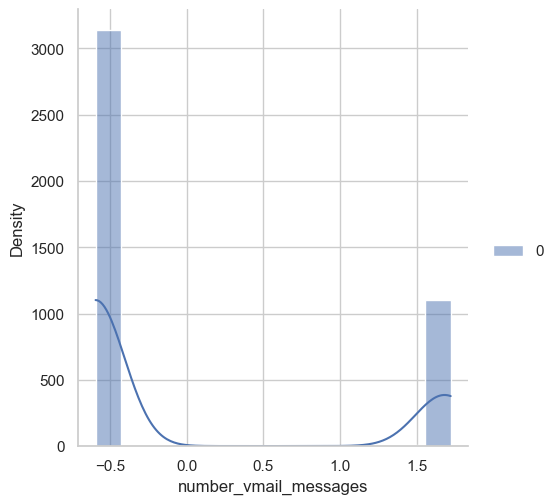

,state,account_length,area_code,international_plan,voice_mail_plan,total_day_minutes,total_day_calls,total_day_charge,total_eve_minutes,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_charge,churn,YJ_total_intl_calls,YJ_number_customer_service_calls,YJ_number_vmail_messages
0,OH,107,area_code_415,no,yes,161.6,123,27.47,195.5,103,16.62,254.4,103,11.45,13.7,3.70,no,-0.491941,-0.255052,1.678258
1,NJ,137,area_code_415,no,no,243.4,114,41.38,121.2,110,10.30,162.6,104,7.32,12.2,3.29,no,0.423687,-1.522612,-0.594848
2,OH,84,area_code_408,yes,no,299.4,71,50.90,61.9,88,5.26,196.9,89,8.86,6.6,1.78,no,1.100522,0.536480,-0.594848
3,OK,75,area_code_415,yes,no,166.7,113,28.34,148.3,122,12.61,186.9,121,8.41,10.1,2.73,no,-0.491941,1.121753,-0.594848
4,MA,121,area_code_510,no,yes,218.2,88,37.09,348.5,108,29.62,212.6,118,9.57,7.5,2.03,no,1.100522,1.121753,1.671188


In [14]:
def yj_transform(df_col):
    converted_to_2D_array = np.array([df_col]).reshape(len(df_col),1)
    transformed_values = power_transform(converted_to_2D_array)
    return transformed_values

def logplus1_transform(df_col):
    transformed_values = np.log(np.array(df_col)+1)
    return transformed_values

columns_to_scale = ['total_intl_calls','number_customer_service_calls','number_vmail_messages']
for features in columns_to_scale:
    sns.set(style="whitegrid")
    plt.figure(figsize=(2,2))
    sns.displot(yj_transform(train_raw[features]),kde=True)
    plt.xlabel(features)
    plt.ylabel('Density')
    plt.show()

training = train_raw.drop(columns_to_scale, axis=1)
for col in columns_to_scale:
    new_col_name = 'YJ_'+col
    training[new_col_name] = yj_transform(train_raw[col])

training.head()

['account_length', 'total_day_minutes', 'total_day_calls', 'total_day_charge', 'total_eve_minutes', 'total_eve_calls', 'total_eve_charge', 'total_night_minutes', 'total_night_calls', 'total_night_charge', 'total_intl_minutes', 'total_intl_charge', 'YJ_total_intl_calls', 'YJ_number_customer_service_calls', 'YJ_number_vmail_messages']


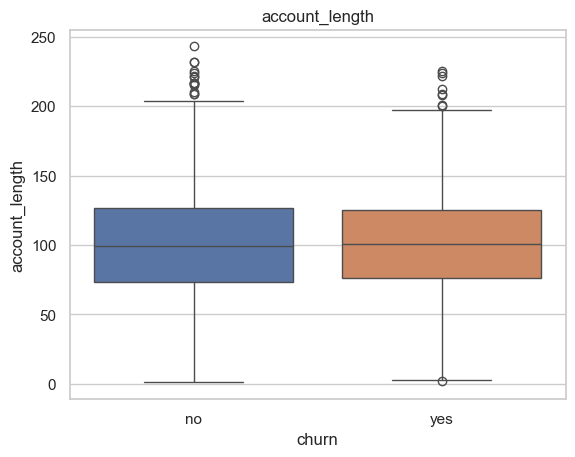

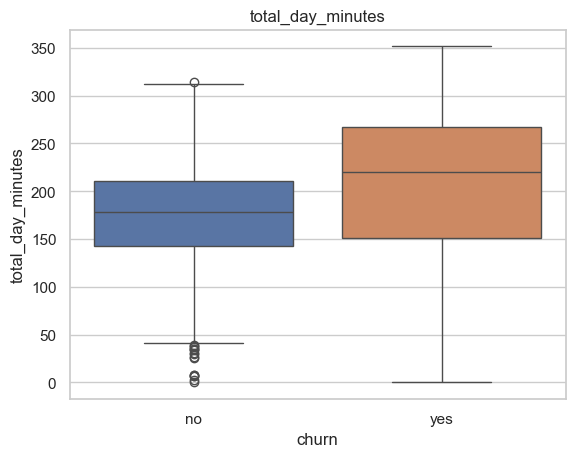

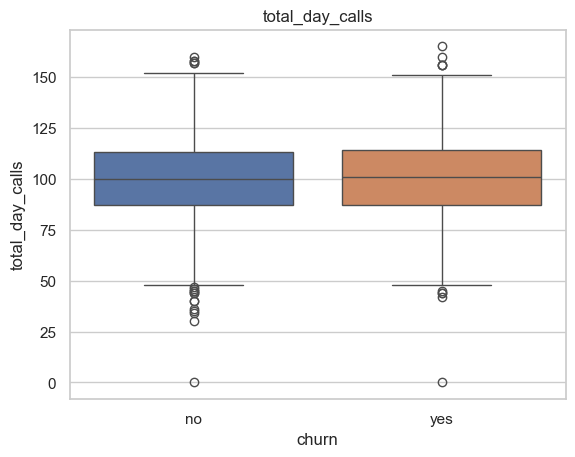

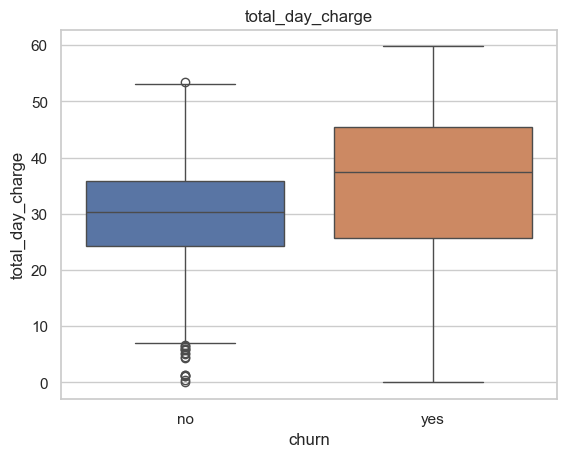

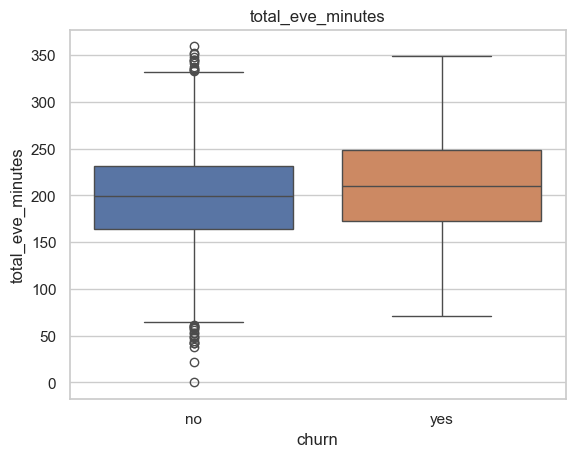

...

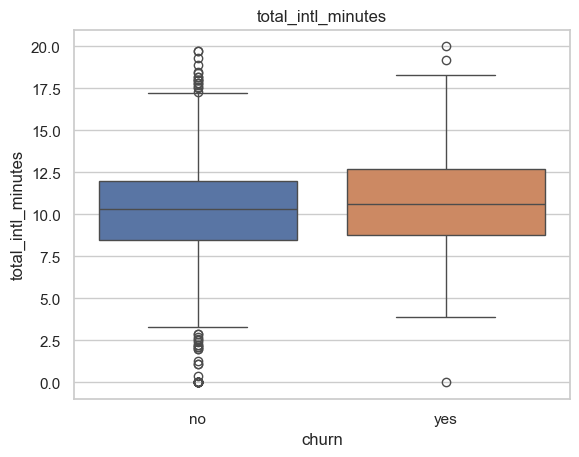

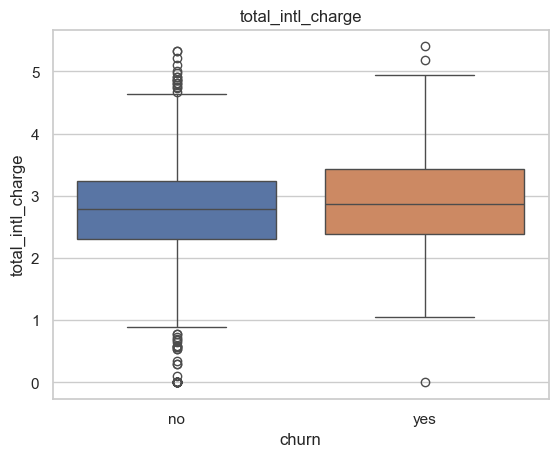

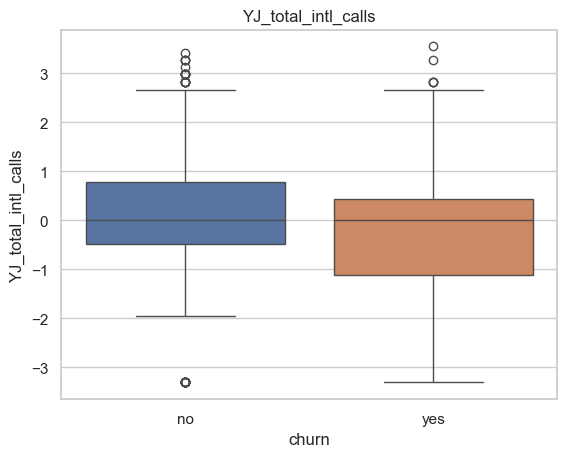

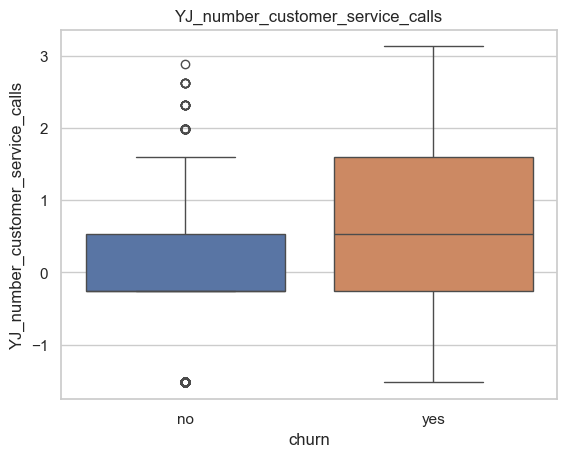

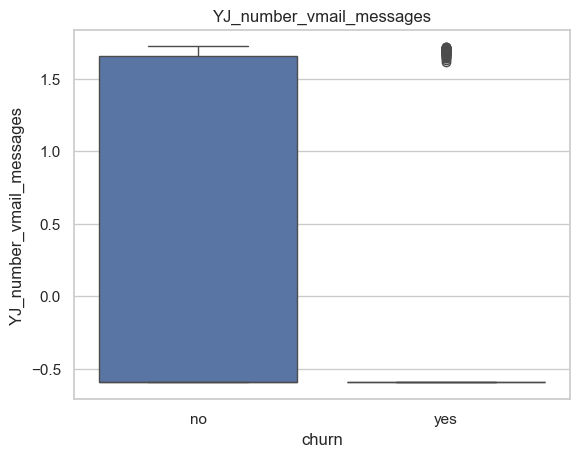

In [15]:
# -- refresh numerical features list with new dataframe
num_ftrs = [features for features in training.columns if training[features].dtype != 'object']
print(num_ftrs)

for features in num_ftrs:
    if features != 'churn' :
        sns.boxplot(x = 'churn', y = features, data = training, hue='churn')
        plt.title(features)
        plt.show()

Next, we'll remove outliers from our dataset.

In [16]:
def outlier_3sigma(df_col):
    mean = np.mean(df_col)
    std = np.std(df_col)

    outlier_ind = []
    for i in range(len(df_col)):
        if np.abs((df_col[i]-mean)/std) > 3:
            outlier_ind.append(i)
    return outlier_ind

outliers = []
for features in num_ftrs:
    outliers.extend(outlier_3sigma(training[features]))

outliers = list(set(outliers))
training = training.drop(index=outliers)
training.reset_index(drop=True, inplace=True)
print('Number of outliers:',len(outliers))
print('Number of remaining training examples:',len(training))

Number of outliers: 113
Number of remaining training examples: 4137


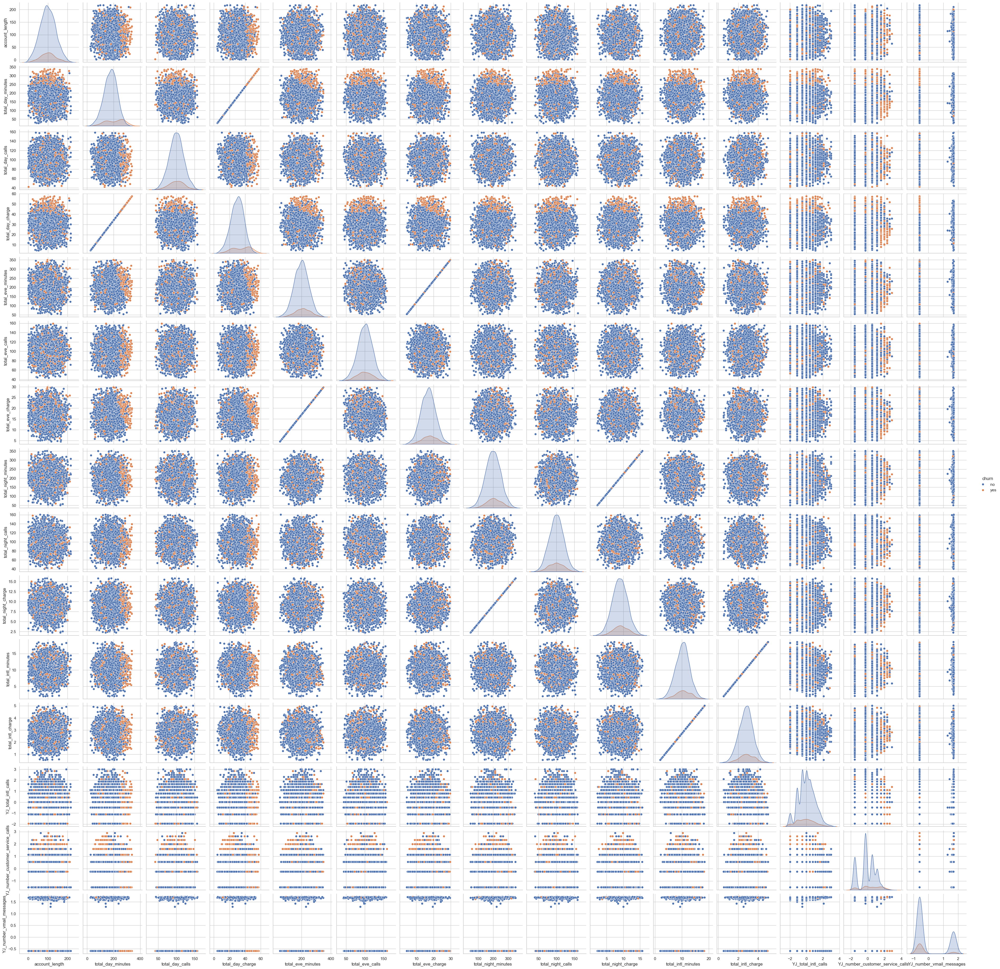

In [17]:
sns.pairplot(training, hue="churn")

Next we'll normalize remaining numerical features

In [18]:
# def zscore_norm(df_col):
#     norm_vals = []
#     mean = np.mean(df_col)
#     std = np.std(df_col)
#     for i in range(len(df_col)):
#         norm_vals.append((df_col[i]-mean)/std)
#     return norm_vals

# for features in num_ftrs:
#     training[features] = zscore_norm(training[features])

scaler = StandardScaler()
training[num_ftrs] = scaler.fit_transform(training[num_ftrs])
training.head()

,state,account_length,area_code,international_plan,voice_mail_plan,total_day_minutes,total_day_calls,total_day_charge,total_eve_minutes,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_charge,churn,YJ_total_intl_calls,YJ_number_customer_service_calls,YJ_number_vmail_messages
0,OH,0.179718,area_code_415,no,yes,-0.351097,1.180510,-0.351378,-0.097896,0.142224,-0.097356,1.092815,0.161171,1.093642,1.291205,1.291932,no,-0.521476,-0.254868,1.674393
1,NJ,0.943109,area_code_415,no,no,1.178794,0.720462,1.178956,-1.597855,0.498110,-1.598385,-0.762223,0.211634,-0.760936,0.719625,0.713275,no,0.426458,-1.524165,-0.596167
2,OH,-0.405549,area_code_408,yes,no,2.226153,-1.477547,2.226317,-2.794995,-0.620389,-2.795408,-0.069110,-0.545308,-0.069398,-1.414271,-1.417880,no,1.127173,0.537748,-0.596167
3,OK,-0.634566,area_code_415,yes,no,-0.255713,0.669345,-0.255663,-1.050764,1.108201,-1.049749,-0.271183,1.069502,-0.271471,-0.080586,-0.077088,no,-0.521476,1.123823,-0.596167
4,MA,0.535967,area_code_510,no,yes,0.707483,-0.608566,0.706984,2.990847,0.396429,2.990204,0.248146,0.918114,0.249427,-1.071323,-1.065040,no,1.127173,1.123823,1.667331


Finally, we one-hot encode categorical features. Because `international_plan`, `voice_mail_plan`, and `churn` are binary, we don't really need to encode them.

In [19]:
print(cat_ftrs)
training = pd.get_dummies(training, drop_first=True, dtype=int)
training = training.rename(columns={
    "international_plan_yes": "international_plan", 
    "voice_mail_plan_yes": "voice_mail_plan",
    "churn_yes": "churn"
    })
training.head()

['state', 'area_code', 'international_plan', 'voice_mail_plan', 'churn']


,account_length,total_day_minutes,total_day_calls,total_day_charge,total_eve_minutes,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,...,state_VT,state_WA,state_WI,state_WV,state_WY,area_code_area_code_415,area_code_area_code_510,international_plan,voice_mail_plan,churn
0,0.179718,-0.351097,1.180510,-0.351378,-0.097896,0.142224,-0.097356,1.092815,0.161171,1.093642,...,0,0,0,0,0,1,0,0,1,0
1,0.943109,1.178794,0.720462,1.178956,-1.597855,0.498110,-1.598385,-0.762223,0.211634,-0.760936,...,0,0,0,0,0,1,0,0,0,0
2,-0.405549,2.226153,-1.477547,2.226317,-2.794995,-0.620389,-2.795408,-0.069110,-0.545308,-0.069398,...,0,0,0,0,0,0,0,1,0,0
3,-0.634566,-0.255713,0.669345,-0.255663,-1.050764,1.108201,-1.049749,-0.271183,1.069502,-0.271471,...,0,0,0,0,0,1,0,1,0,0
4,0.535967,0.707483,-0.608566,0.706984,2.990847,0.396429,2.990204,0.248146,0.918114,0.249427,...,0,0,0,0,0,0,1,0,1,0


### 3. Model Initialization

Let's try a few algorithms to see how they perform

In [20]:
training.head()

,account_length,total_day_minutes,total_day_calls,total_day_charge,total_eve_minutes,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,...,state_VT,state_WA,state_WI,state_WV,state_WY,area_code_area_code_415,area_code_area_code_510,international_plan,voice_mail_plan,churn
0,0.179718,-0.351097,1.180510,-0.351378,-0.097896,0.142224,-0.097356,1.092815,0.161171,1.093642,...,0,0,0,0,0,1,0,0,1,0
1,0.943109,1.178794,0.720462,1.178956,-1.597855,0.498110,-1.598385,-0.762223,0.211634,-0.760936,...,0,0,0,0,0,1,0,0,0,0
2,-0.405549,2.226153,-1.477547,2.226317,-2.794995,-0.620389,-2.795408,-0.069110,-0.545308,-0.069398,...,0,0,0,0,0,0,0,1,0,0
3,-0.634566,-0.255713,0.669345,-0.255663,-1.050764,1.108201,-1.049749,-0.271183,1.069502,-0.271471,...,0,0,0,0,0,1,0,1,0,0
4,0.535967,0.707483,-0.608566,0.706984,2.990847,0.396429,2.990204,0.248146,0.918114,0.249427,...,0,0,0,0,0,0,1,0,1,0


In [21]:
# -- split training data into training and cross-validation sets
training_features = training.drop(['churn'], axis=1)
target = training.filter(['churn'], axis=1)
X_train, X_dev, y_train, y_dev = train_test_split(training_features, target, test_size=0.2, random_state=51)

comp_y = np.array(y_dev['churn'])

rf = RandomForestClassifier()
gbc = GradientBoostingClassifier()
ada = AdaBoostClassifier()
xgbc = xgb.XGBClassifier()

# -- fitting and prediction function
def predict_models(model, model_name):
    fit_model = model.fit(X_train, y_train)
    y_predict = fit_model.predict(X_dev)
    correct = [1. for i in range(len(comp_y)) if y_predict[i]==comp_y[i]]
    perf = sum(correct)/len(comp_y)
    print(model_name, perf)

In [26]:
predict_models(rf,"RandomForest")

RandomForest 0.9432367149758454


In [27]:
predict_models(gbc,"GradientBoosting")

GradientBoosting 0.9480676328502415


In [24]:
predict_models(ada, "AdaBoost")

AdaBoost 0.8852657004830918


In [25]:
predict_models(xgbc, "XGBoost")

XGBoost 0.9480676328502415


Let's tune these models more to see if we can improve performance

### 4. Model Tuning

We will set up a grid search to tune our hyperparameters

In [28]:
param_grid_rf = {
    'n_estimators': [100, 200, 300],
    'max_depth': [3, 5, 7],
    'max_features': ['sqrt', 'log2'],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}
cls_rf = GridSearchCV(rf, param_grid = param_grid_rf, cv=5,verbose=True, n_jobs=-1)
best_rf = cls_rf.fit(X_train, np.ravel(y_train))
predict_models(best_rf, 'HyperParameterized Random Forest')

Fitting 5 folds for each of 162 candidates, totalling 810 fits
Fitting 5 folds for each of 162 candidates, totalling 810 fits


/Users/rweverson/miniconda3/envs/ds_rocket/lib/python3.10/site-packages/sklearn/base.py:1473: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)
/Users/rweverson/miniconda3/envs/ds_rocket/lib/python3.10/site-packages/sklearn/base.py:1473: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)
/Users/rweverson/miniconda3/envs/ds_rocket/lib/python3.10/site-packages/sklearn/base.py:1473: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)
/Users/rweverson/miniconda3/envs/ds_rocket/lib/python3.10/site-packages/sklearn/base.py:1473: DataConversionW

HyperParameterized Random Forest 0.892512077294686


In [29]:
param_grid_ada = {
    'n_estimators': [100, 200],
    'learning_rate': [0.2,0.5],
    'algorithm': ['SAMME','SAMME']
}

cls_ada = GridSearchCV(ada, param_grid=param_grid_ada, cv=5, verbose=True, n_jobs=-1)
best_ada = cls_ada.fit(X_train, y_train.values.ravel())
predict_models(best_ada, 'HyperParameterized AdaBoost')

Fitting 5 folds for each of 8 candidates, totalling 40 fits
Fitting 5 folds for each of 8 candidates, totalling 40 fits


/Users/rweverson/miniconda3/envs/ds_rocket/lib/python3.10/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/rweverson/miniconda3/envs/ds_rocket/lib/python3.10/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/rweverson/miniconda3/envs/ds_rocket/lib/python3.10/site-packages/sklearn/utils/validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/rweverson/miniconda3/envs/ds_rocket/lib/python3.10/site-packages/sklearn/utils/validation.py:1339: DataConve

HyperParameterized AdaBoost 0.8780193236714976


In [30]:
param_grid_xgb = {
  'n_estimators': [100, 200],
  'max_depth': [3, 5],
  'learning_rate': [0.01, 0.05],
  'subsample': [0.8, 0.9],
  'colsample_bytree': [0.8, 0.9],
  'min_child_weight': [1, 5],
  'gamma': [0, 0.1]
}
cls_xgbc = GridSearchCV(xgbc, param_grid = param_grid_xgb, cv=5,verbose=True, n_jobs=-1)
best_xgbc = cls_xgbc.fit(X_train,y_train.values.ravel())
predict_models(best_xgbc, 'HyperParameterized XGBoost')

Fitting 5 folds for each of 128 candidates, totalling 640 fits
Fitting 5 folds for each of 128 candidates, totalling 640 fits
HyperParameterized XGBoost 0.9528985507246377


### 5. Results

Ranked by performance:

- Hyperparameterized XGBoost Classifer : 0.9528985507246377
- XGBoost Classifier : 0.9480676328502415
- Random Forest Classifier : 0.9420289855072463
- Hyperparameterized Random Forest : 0.892512077294686
- AdaBoost Classifier : 0.8852657004830918
- Hyperparameterized AdaBoost Classifier : 0.8780193236714976

